In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import math
import seaborn as sns
import json
import powerlaw
import geopandas as gdp
import scipy

In [2]:
%matplotlib inline

In [3]:
!ls ../geo_data

OA_2021_EW_BFC_V7.cpg
OA_2021_EW_BFC_V7.dbf
OA_2021_EW_BFC_V7.prj
OA_2021_EW_BFC_V7.shp
OA_2021_EW_BFC_V7.shx
Output_Areas_Dec_2021_Boundaries_Full_Clipped_EW_BFC_2022_-340120420164038365.csv
Output_Areas_Dec_2021_Boundaries_Full_Clipped_EW_BFC_2022_5714326745691218172.zip
PARNCP_DEC_2021_EW_BSC.cpg
PARNCP_DEC_2021_EW_BSC.dbf
PARNCP_DEC_2021_EW_BSC.prj
PARNCP_DEC_2021_EW_BSC.shp
PARNCP_DEC_2021_EW_BSC.shx
Parishes_and_Non_Civil_Parished_Areas_(December_2021)_EW_BSC.xml
Parishes_and_Non_Civil_Parished_Areas_(December_2021)_EW_BSC.zip
Sheffield Primary School Catchments 2016 17 2.zip
Sheffield_Primary_School_Catchments_2016-17.cpg
Sheffield_Primary_School_Catchments_2016-17.dbf
Sheffield_Primary_School_Catchments_2016-17.prj
Sheffield_Primary_School_Catchments_2016-17.sbn
Sheffield_Primary_School_Catchments_2016-17.sbx
Sheffield_Primary_School_Catchments_2016-17.shp
Sheffield_Primary_School_Catchments_2016-17.shp.xml
Sheffield_Primary_School_Catchments_2016-17.shx


In [4]:
geo_df = gdp.read_file('../geo_data/Sheffield_Primary_School_Catchments_2016-17.shp')
geo_df.head()

,CATCH_NUM,CATCHMENT,Shape_area,Shape_len,geometry
0,2001,Abbey Lane IJ,2.812735e+06,11091.133823,"POLYGON ((434127.999 383317.331, 434148.002 38..."
1,2002,Nether Edge NIJ,8.801766e+05,5517.909354,"POLYGON ((434152.875 385479.565, 434160.976 38..."
2,2343,Anns Grove NIJ,1.203991e+06,7690.489053,"POLYGON ((436026.927 386125.100, 436032.880 38..."
3,3429,Arbourthorne NIJ,8.184401e+05,5726.122791,"POLYGON ((436449.297 384640.032, 436458.705 38..."
4,2322,Bankwood NIJ,1.252839e+06,6128.917022,"POLYGON ((436110.697 384694.737, 436125.299 38..."


In [5]:
geo_df.to_crs(epsg=3857, inplace=True)

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_77784/677303777.py:5: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(geo_df.geometry))


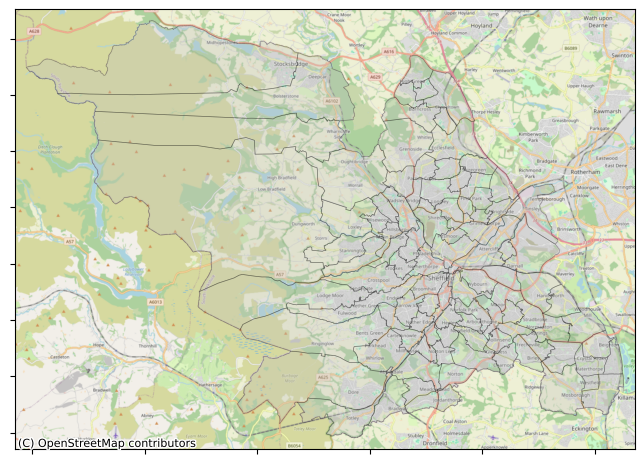

In [8]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(8,12))
# Define Overall Polygon
overall_polygon = gdp.GeoSeries(cascaded_union(geo_df.geometry))
# Define bounding box
bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)

# Plot borough borders
geo_df.plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='black', 
    linewidth=0.5,
    facecolor='silver',
)

import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

plt.show()

In [9]:
!ls ../data

Index_of_Multiple_Deprivation_(Dec_2019)_Lookup_in_England.csv
OA_(2011)_to_OA_(2021)_to_Local_Authority_District_(2022)_for_England_and_Wales_Lookup_(Version_2).csv
OAs_(2021)_to_Civil_Parish_and_Non-Civil_Parished_Areas_to_LTLA_to_UTLA_to_Region_to_Country_(May_2022)_Lookup_in_England_and_Wales.csv
Output_Area_to_Lower_layer_Super_Output_Area_to_Middle_layer_Super_Output_Area_to_Local_Authority_District_(December_2011)_Lookup_in_England_and_Wales.csv
RUC11_OA11_EW.csv
all_data_final_Cambridgeshire.json
all_data_final_Cumbria.json
all_data_final_Derbyshire.json
all_data_final_Devon.json
all_data_final_East Sussex.json
all_data_final_Essex.json
all_data_final_Gloucestershire.json
all_data_final_Greater Manchester.json
all_data_final_Hampshire.json
all_data_final_Hertfordshire.json
all_data_final_Inner London.json
all_data_final_Kent.json
all_data_final_Lancashire.json
all_data_final_Leicestershire.json
all_data_final_Lincolnshire.json
all_data_final_Merseyside.json
all_data_final_Norfo

In [12]:
school_data = pd.read_csv('../data/edubasealldata20230519.csv', encoding = "ISO-8859-1")
school_data.head()

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_77784/164457799.py:1: DtypeWarning: Columns (30,31,38,46,48,50,51,55,72,73,81,86,87,88,89,90,91,92,93,94,95,96,117,120,121,125,126,129) have mixed types. Specify dtype option on import or set low_memory=False.
  school_data = pd.read_csv('../data/edubasealldata20230519.csv', encoding = "ISO-8859-1")


,URN,LA (code),LA (name),EstablishmentNumber,EstablishmentName,TypeOfEstablishment (code),TypeOfEstablishment (name),EstablishmentTypeGroup (code),EstablishmentTypeGroup (name),EstablishmentStatus (code),...,SiteName,QABName (code),QABName (name),EstablishmentAccredited (code),EstablishmentAccredited (name),QABReport,CHNumber,MSOA (code),LSOA (code),FSM
0,100000,201,City of London,3614.0,The Aldgate School,2,Voluntary aided school,4,Local authority maintained schools,1,...,NaN,0,Not applicable,0,Not applicable,NaN,NaN,E02000001,E01032739,62.0
1,100001,201,City of London,6005.0,City of London School for Girls,11,Other independent school,3,Independent schools,1,...,NaN,0,Not applicable,0,Not applicable,NaN,NaN,E02000001,E01000002,0.0
2,100002,201,City of London,6006.0,St Paul's Cathedral School,11,Other independent school,3,Independent schools,1,...,NaN,0,Not applicable,0,Not applicable,NaN,NaN,E02000001,E01032739,0.0
3,100003,201,City of London,6007.0,City of London School,11,Other independent school,3,Independent schools,1,...,NaN,0,Not applicable,0,Not applicable,NaN,NaN,E02000001,E01032739,0.0
4,100004,202,Camden,1045.0,Sherborne Nursery School,15,Local authority nursery school,4,Local authority maintained schools,2,...,NaN,0,Not applicable,0,Not applicable,NaN,NaN,E02000172,E01000901,NaN


In [13]:
school_data.columns.values

array(['URN', 'LA (code)', 'LA (name)', 'EstablishmentNumber',
       'EstablishmentName', 'TypeOfEstablishment (code)',
       'TypeOfEstablishment (name)', 'EstablishmentTypeGroup (code)',
       'EstablishmentTypeGroup (name)', 'EstablishmentStatus (code)',
       'EstablishmentStatus (name)', 'ReasonEstablishmentOpened (code)',
       'ReasonEstablishmentOpened (name)', 'OpenDate',
       'ReasonEstablishmentClosed (code)',
       'ReasonEstablishmentClosed (name)', 'CloseDate',
       'PhaseOfEducation (code)', 'PhaseOfEducation (name)',
       'StatutoryLowAge', 'StatutoryHighAge', 'Boarders (code)',
       'Boarders (name)', 'NurseryProvision (name)',
       'OfficialSixthForm (code)', 'OfficialSixthForm (name)',
       'Gender (code)', 'Gender (name)', 'ReligiousCharacter (code)',
       'ReligiousCharacter (name)', 'ReligiousEthos (name)',
       'Diocese (code)', 'Diocese (name)', 'AdmissionsPolicy (code)',
       'AdmissionsPolicy (name)', 'SchoolCapacity',
       'SpecialCl

In [15]:
import pyproj

crs_british = pyproj.Proj(init='EPSG:27700')
crs_wgs84 = pyproj.Proj(init='EPSG:4326')

long, lat = pyproj.transform(crs_british, crs_wgs84, 517393.6563, 194035.5469)
print(lat, long)

51.6328909046718 -0.3052119183057833


/Users/msharpe/Downloads/new_parishes_shapefiles/my_project/lib/python3.9/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/msharpe/Downloads/new_parishes_shapefiles/my_project/lib/python3.9/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_77784/216215088.py:6: FutureWarning: This function is deprecated. See: 

In [16]:
def covert_thing(easting, northing):
    return pyproj.transform(crs_british, crs_wgs84, easting, northing)

In [21]:
school_data[school_data.URN == 121393][['Easting', 'Northing']]

,Easting,Northing
21378,444791.0,461825.0


In [22]:
covert_thing(444791.0, 461825.0)

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_77784/3452617864.py:2: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  return pyproj.transform(crs_british, crs_wgs84, easting, northing)


(-1.3173643568602647, 54.05044859622498)

### Sheffield Schools

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_77784/4136782563.py:3: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  boundary = gdp.GeoSeries(cascaded_union(polygons))


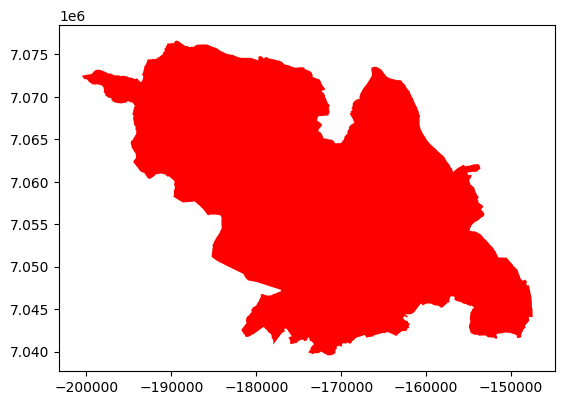

In [24]:
from shapely.ops import cascaded_union
polygons = geo_df.geometry.values
boundary = gdp.GeoSeries(cascaded_union(polygons))
boundary.plot(color = 'red')
plt.show()

In [27]:
from shapely.geometry import Point

def to_keep(x, bounds):
    easting = x['Easting']
    northing = x['Northing']
    long, lat = pyproj.transform(crs_british, crs_wgs84, easting, northing)
    p = Point(long, lat)
    return bounds.contains(p)

In [49]:
def convert_thing(x):
    easting = x['Easting']
    northing = x['Northing']
    long, lat = pyproj.transform(crs_british, crs_wgs84, easting, northing)
    return long, lat

In [67]:
sheffield_schools = school_data[school_data['LA (name)'] == 'Sheffield']
sheffield_schools.shape

(465, 139)

In [77]:
geometry = [Point(xy) for xy in zip(sheffield_schools['Easting'], sheffield_schools['Northing'])]
crs = 'EPSG:27700'
sheff_gdf = GeoDataFrame(sheffield_schools, geometry=geometry, crs=crs)
sheff_gdf = sheff_gdf.to_crs('3857')
sheff_gdf.head()

,URN,LA (code),LA (name),EstablishmentNumber,EstablishmentName,TypeOfEstablishment (code),TypeOfEstablishment (name),EstablishmentTypeGroup (code),EstablishmentTypeGroup (name),EstablishmentStatus (code),...,QABName (code),QABName (name),EstablishmentAccredited (code),EstablishmentAccredited (name),QABReport,CHNumber,MSOA (code),LSOA (code),FSM,geometry
6967,106973,373,Sheffield,1000.0,Broomhall Nursery School,15,Local authority nursery school,4,Local authority maintained schools,1,...,0,Not applicable,0,Not applicable,NaN,NaN,E02006844,E01008115,2.0,POINT (-165454.616 7052701.286)
6968,106974,373,Sheffield,1001.0,Denby Street Nursery School,15,Local authority nursery school,4,Local authority maintained schools,2,...,0,Not applicable,0,Not applicable,NaN,NaN,E02001650,E01008105,NaN,POINT (-164037.721 7051969.749)
6969,106975,373,Sheffield,1002.0,Grace Owen Nursery School,15,Local authority nursery school,4,Local authority maintained schools,1,...,0,Not applicable,0,Not applicable,NaN,NaN,E02006868,E01033268,3.0,POINT (-162351.547 7053917.910)
6970,106976,373,Sheffield,1003.0,Birley Nursery School,15,Local authority nursery school,4,Local authority maintained schools,2,...,0,Not applicable,0,Not applicable,NaN,NaN,E02006869,E01007842,NaN,POINT (-156239.365 7046545.000)
6971,106977,373,Sheffield,1005.0,Wybourn Nursery School,15,Local authority nursery school,4,Local authority maintained schools,2,...,0,Not applicable,0,Not applicable,NaN,NaN,E02006868,E01007878,NaN,POINT (-160926.368 7053400.350)


In [80]:
geo_df.head()

,CATCH_NUM,CATCHMENT,Shape_area,Shape_len,geometry
0,2001,Abbey Lane IJ,2.812735e+06,11091.133823,"POLYGON ((-165736.576 7047192.556, -165703.449..."
1,2002,Nether Edge NIJ,8.801766e+05,5517.909354,"POLYGON ((-165669.086 7050817.062, -165655.826..."
2,2343,Anns Grove NIJ,1.203991e+06,7690.489053,"POLYGON ((-162526.055 7051876.426, -162516.392..."
3,3429,Arbourthorne NIJ,8.184401e+05,5726.122791,"POLYGON ((-161838.427 7049380.957, -161822.607..."
4,2322,Bankwood NIJ,1.252839e+06,6128.917022,"POLYGON ((-162404.033 7049476.989, -162379.696..."


In [81]:
sheff_gdf[sheff_gdf.EstablishmentName.apply(lambda x: 'Abbey' in x)]

,URN,LA (code),LA (name),EstablishmentNumber,EstablishmentName,TypeOfEstablishment (code),TypeOfEstablishment (name),EstablishmentTypeGroup (code),EstablishmentTypeGroup (name),EstablishmentStatus (code),...,QABName (code),QABName (name),EstablishmentAccredited (code),EstablishmentAccredited (name),QABReport,CHNumber,MSOA (code),LSOA (code),FSM,geometry
6976,106982,373,Sheffield,2001.0,Abbey Lane Primary School,1,Community school,4,Local authority maintained schools,1,...,0,Not applicable,0,Not applicable,NaN,NaN,E02001676,E01007834,78.0,POINT (-165304.541 7045884.974)
7130,107137,373,Sheffield,4254.0,Abbeydale Grange School,5,Foundation school,4,Local authority maintained schools,2,...,0,Not applicable,0,Not applicable,NaN,NaN,E02001665,E01007929,NaN,POINT (-166674.610 7047671.353)
42001,143052,373,Sheffield,2046.0,Abbeyfield Primary Academy,28,Academy sponsor led,10,Academies,1,...,0,Not applicable,0,Not applicable,NaN,NaN,E02001629,E01007870,175.0,POINT (-162968.045 7057855.680)


In [88]:
sheff_gdf.groupby('PhaseOfEducation (name)').size().sort_values(ascending=False)

PhaseOfEducation (name)
Primary                    293
Secondary                   69
Not applicable              67
Middle deemed primary       22
Nursery                      5
16 plus                      4
All-through                  3
Middle deemed secondary      2
dtype: int64

In [86]:
sheff_gdf.columns.values

array(['URN', 'LA (code)', 'LA (name)', 'EstablishmentNumber',
       'EstablishmentName', 'TypeOfEstablishment (code)',
       'TypeOfEstablishment (name)', 'EstablishmentTypeGroup (code)',
       'EstablishmentTypeGroup (name)', 'EstablishmentStatus (code)',
       'EstablishmentStatus (name)', 'ReasonEstablishmentOpened (code)',
       'ReasonEstablishmentOpened (name)', 'OpenDate',
       'ReasonEstablishmentClosed (code)',
       'ReasonEstablishmentClosed (name)', 'CloseDate',
       'PhaseOfEducation (code)', 'PhaseOfEducation (name)',
       'StatutoryLowAge', 'StatutoryHighAge', 'Boarders (code)',
       'Boarders (name)', 'NurseryProvision (name)',
       'OfficialSixthForm (code)', 'OfficialSixthForm (name)',
       'Gender (code)', 'Gender (name)', 'ReligiousCharacter (code)',
       'ReligiousCharacter (name)', 'ReligiousEthos (name)',
       'Diocese (code)', 'Diocese (name)', 'AdmissionsPolicy (code)',
       'AdmissionsPolicy (name)', 'SchoolCapacity',
       'SpecialCl

In [94]:
pd.set_option('display.max_columns', 500)

In [95]:
sheff_gdf[sheff_gdf['PhaseOfEducation (name)'] == 'Primary'].head()

,URN,LA (code),LA (name),EstablishmentNumber,EstablishmentName,TypeOfEstablishment (code),TypeOfEstablishment (name),EstablishmentTypeGroup (code),EstablishmentTypeGroup (name),EstablishmentStatus (code),EstablishmentStatus (name),ReasonEstablishmentOpened (code),ReasonEstablishmentOpened (name),OpenDate,ReasonEstablishmentClosed (code),ReasonEstablishmentClosed (name),CloseDate,PhaseOfEducation (code),PhaseOfEducation (name),StatutoryLowAge,StatutoryHighAge,Boarders (code),Boarders (name),NurseryProvision (name),OfficialSixthForm (code),OfficialSixthForm (name),Gender (code),Gender (name),ReligiousCharacter (code),ReligiousCharacter (name),ReligiousEthos (name),Diocese (code),Diocese (name),AdmissionsPolicy (code),AdmissionsPolicy (name),SchoolCapacity,SpecialClasses (code),SpecialClasses (name),CensusDate,NumberOfPupils,NumberOfBoys,NumberOfGirls,PercentageFSM,TrustSchoolFlag (code),TrustSchoolFlag (name),Trusts (code),Trusts (name),SchoolSponsorFlag (name),SchoolSponsors (name),FederationFlag (name),Federations (code),Federations (name),UKPRN,FEHEIdentifier,FurtherEducationType (name),OfstedLastInsp,OfstedSpecialMeasures (code),OfstedSpecialMeasures (name),LastChangedDate,Street,Locality,Address3,Town,County (name),Postcode,SchoolWebsite,TelephoneNum,HeadTitle (name),HeadFirstName,HeadLastName,HeadPreferredJobTitle,BSOInspectorateName (name),InspectorateReport,DateOfLastInspectionVisit,NextInspectionVisit,TeenMoth (name),TeenMothPlaces,CCF (name),SENPRU (name),EBD (name),PlacesPRU,FTProv (name),EdByOther (name),Section41Approved (name),SEN1 (name),SEN2 (name),SEN3 (name),SEN4 (name),SEN5 (name),SEN6 (name),SEN7 (name),SEN8 (name),SEN9 (name),SEN10 (name),SEN11 (name),SEN12 (name),SEN13 (name),TypeOfResourcedProvision (name),ResourcedProvisionOnRoll,ResourcedProvisionCapacity,SenUnitOnRoll,SenUnitCapacity,GOR (code),GOR (name),DistrictAdministrative (code),DistrictAdministrative (name),AdministrativeWard (code),AdministrativeWard (name),ParliamentaryConstituency (code),ParliamentaryConstituency (name),UrbanRural (code),UrbanRural (name),GSSLACode (name),Easting,Northing,MSOA (name),LSOA (name),InspectorateName (name),SENStat,SENNoStat,BoardingEstablishment (name),PropsName,PreviousLA (code),PreviousLA (name),PreviousEstablishmentNumber,OfstedRating (name),RSCRegion (name),Country (name),UPRN,SiteName,QABName (code),QABName (name),EstablishmentAccredited (code),EstablishmentAccredited (name),QABReport,CHNumber,MSOA (code),LSOA (code),FSM,geometry
6976,106982,373,Sheffield,2001.0,Abbey Lane Primary School,1,Community school,4,Local authority maintained schools,1,Open,0,Not applicable,NaN,0,Not applicable,NaN,2,Primary,4.0,11.0,1,No boarders,No Nursery Classes,2,Does not have a sixth form,3,Mixed,0,Does not apply,Does not apply,0000,Not applicable,0,Not applicable,630.0,2,No Special Classes,20-01-2022,561.0,279.0,282.0,13.9,0,Not applicable,NaN,NaN,Not applicable,NaN,Not under a federation,NaN,NaN,10072602.0,NaN,Not applicable,20-03-2018,0,Not applicable,02-05-2023,Abbey Lane,NaN,NaN,Sheffield,South Yorkshire,S8 0BN,www.abbeylaneprimaryschool.com,1.142745e+09,Mrs,Maxine,Stafford,Headteacher,Not applicable,NaN,NaN,NaN,Not applicable,NaN,Not applicable,Not applicable,Not applicable,NaN,NaN,Not applicable,Not applicable,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Not applicable,NaN,NaN,NaN,NaN,D,Yorkshire and the Humber,E08000019,Sheffield,E05010857,Beauchief and Greenhill,E14000923,"Sheffield, Heeley",B1,(England/Wales) Urban minor conurbation,E08000019,434392.0,382539.0,Sheffield 066,Sheffield 066D,NaN,NaN,NaN,NaN,NaN,999,NaN,NaN,Good,East Midlands and the Humber,NaN,1.000521e+11,NaN,0,Not applicable,0,Not applicable,NaN,NaN,E02001676,E01007834,78.0,POINT (-165304.541 7045884.974)
6977,106983,373,Sheffield,2002.0,The Nether Edge Primary School,1,Community school,4,Local authority maintained schools,2,Closed,0,Not applicable,NaN,10,Academy Converter,31-08-2015,2,Primary,3.0,11.0,1,No boarders,Has Nursery Classes,2,Does no

In [91]:
sheff_gdf[sheff_gdf['PhaseOfEducation (name)'] == 'Primary'].groupby(['TypeOfEstablishment (name)']).size().sort_values(ascending=False)

TypeOfEstablishment (name)
Community school               176
Academy converter               50
Academy sponsor led             25
Voluntary aided school          25
Foundation school               14
Voluntary controlled school      3
dtype: int64

In [ ]:
sheff_gdf[
    (sheff_gdf['PhaseOfEducation (name)'] == 'Primary') & (sheff_gdf['EstablishmentStatus (name)'] == 'Open')
].groupby(['TypeOfEstablishment (name)']).size().sort_values(ascending=False)

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_77784/1528550669.py:5: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(geo_df.geometry))


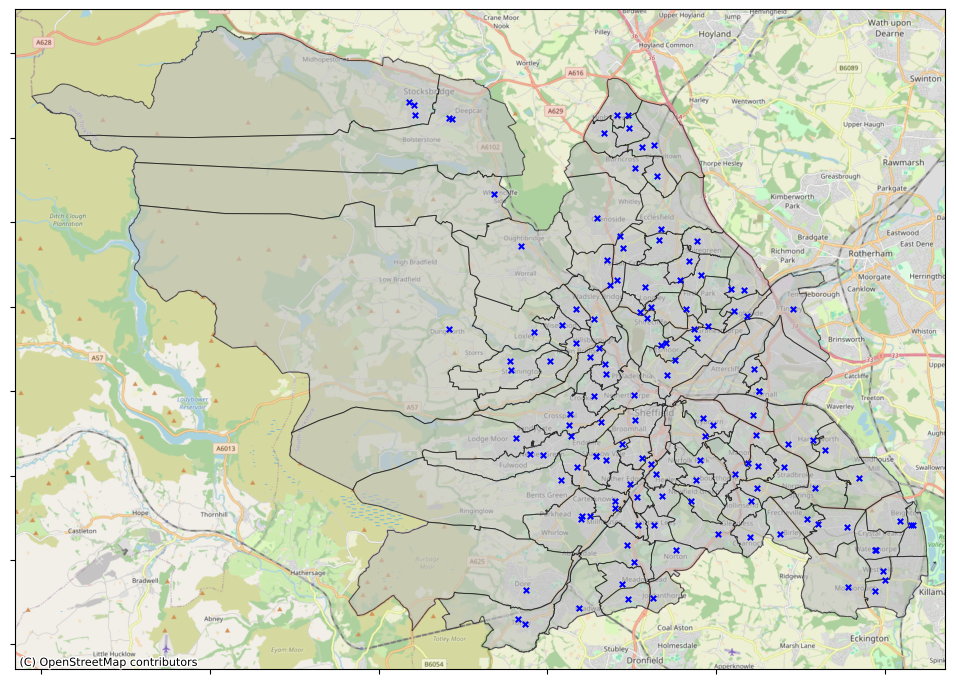

In [96]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(12,18))
# Define Overall Polygon
overall_polygon = gdp.GeoSeries(cascaded_union(geo_df.geometry))
# # Define bounding box
bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)


# Plot primary borders
geo_df.plot(
    ax=ax, 
    alpha=0.6, 
    edgecolor='black', 
    linewidth=0.7,
    facecolor='silver',
)

sheff_gdf[
    (sheff_gdf['PhaseOfEducation (name)'] == 'Primary') & (sheff_gdf['EstablishmentStatus (name)'] == 'Open')
].plot(ax=ax,
                       markersize=15, 
                        color='blue', 
                    marker='x', 
                    label='Neg'
                      )


import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

# import matplotlib.patches as mpatches
# rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
# not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
# small_population_patch = mpatches.Patch(
#     facecolor='red', 
#     edgecolor='red', 
#     alpha=0.8, 
#     label='Smallest population:\n{0} - {1}'.format(
#         mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
#         mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
#     )
# )

# large_population_patch = mpatches.Patch(
#     facecolor='green', 
#     edgecolor='green', 
#     alpha=0.8, 
#     label='Largest population:\n{0} - {1}'.format(
#         mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
#         mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
#     )
# )
# leg = plt.legend(
#     handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
#     bbox_to_anchor=(0.79, 1),
#     loc=2,
#     borderaxespad=0.,
#     frameon=False,
#     prop={'size': 10}
# )
# plt.title("Map of Yorkshire and The Humber's Rural Parishes", fontsize=16)

# plt.savefig('../results/map_of_rural_parishes_yorkshire.png')

plt.show()

In [16]:
parish_data.sort_values(by='area', ascending=True).head(10)

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
3151,E04004731,Gilston,East of England,420,62300.779198,Rural
9228,E04013017,Harlestone Manor,East Midlands,589,162744.046280,Rural
2662,E04004105,Manningtree,East of England,874,200862.181381,Rural
7221,E04010467,Orchard Park,East of England,2499,344758.359665,Urban
3330,E04004952,Downswood,South East,2197,369519.545578,Urban
7666,E04011042,Bache,North West,252,385883.755684,Urban
8616,E04012334,Britwell,South East,2724,390626.264954,Urban
8883,E04012646,Sherfield Park,South East,2387,470580.768394,Urban
7580,E04010939,Edleston,North West,868,490441.392754,Rural
1252,E04001675,Alwalton,East of England,276,493533.963669,Urban


In [17]:
mergey.sort_values(by='SHAPE_Area').head(5)

NameError: name 'mergey' is not defined

In [18]:
parish_data[parish_data.PAR22NM == 'Manningtree']

,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
2662,E04004105,Manningtree,East of England,874,200862.181381,Rural


In [19]:
mergey.sort_values(by='SHAPE_Area', ascending=False).head(5)

NameError: name 'mergey' is not defined

In [20]:
mergey = geo_df.merge(parish_data, how='inner', right_on='PAR22CD', left_on='PARNCP21CD')
mergey.head()

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
0,1,E04000001,Blackrod,NaN,361020,410662,-2.59036,53.591091,14444.180308,8.373290e+06,"POLYGON ((-286096.135 7093910.215, -284094.155...",E04000001,Blackrod,North West,5517,8.599134e+06,Urban
1,2,E04000002,Horwich,NaN,365741,411963,-2.51919,53.603111,20207.437672,1.454181e+07,"POLYGON ((-279457.871 7099705.842, -280193.379...",E04000002,Horwich,North West,20908,1.424275e+07,Mixed
2,3,E04000003,Westhoughton,NaN,365008,406179,-2.52961,53.551079,19733.095935,1.803568e+07,"POLYGON ((-278326.427 7083159.503, -279065.547...",E04000003,Westhoughton,North West,25340,1.786415e+07,Mixed
3,5,E04000005,Saddleworth,NaN,400672,407034,-1.99132,53.559940,41614.516542,7.587037e+07,"POLYGON ((-223693.396 7097907.619, -220596.023...",E04000005,Saddleworth,North West,25466,7.613353e+07,Mixed
4,6,E04000008,Mossley,NaN,398518,402180,-2.02381,53.516312,15077.441495,8.405358e+06,"POLYGON ((-221056.954 7079100.960, -223662.708...",E04000008,Mossley,North West,11566,8.658747e+06,Mixed


/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3569885322.py:5: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mergey.geometry))


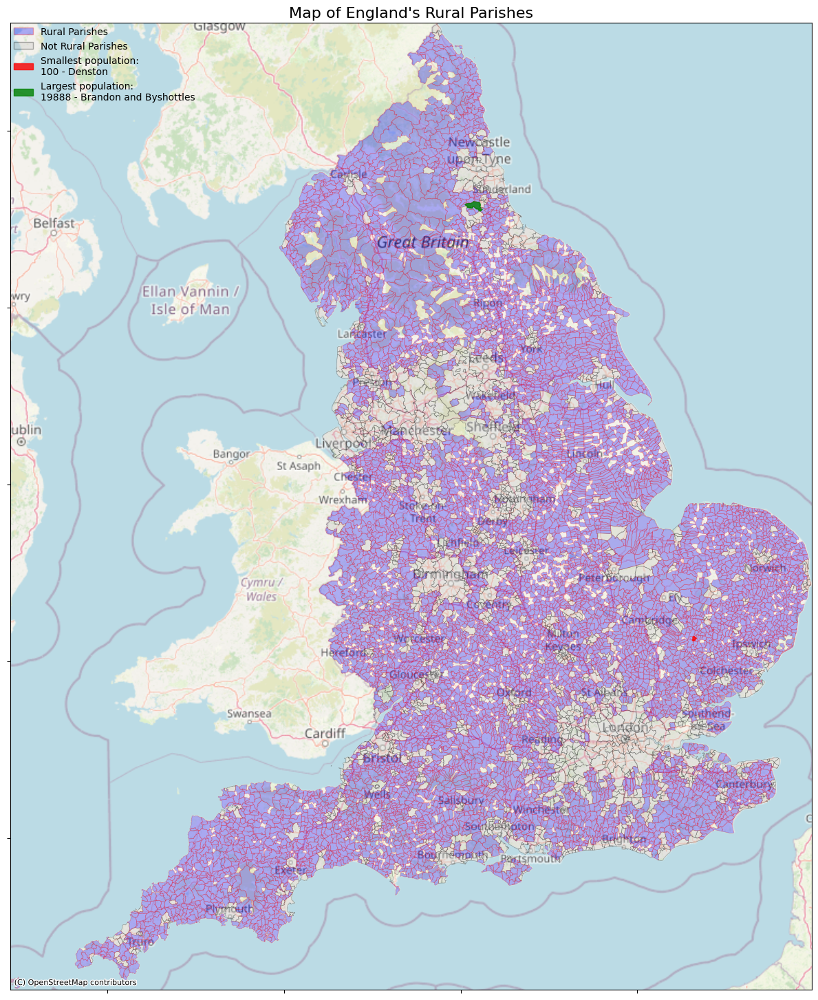

In [22]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(12,18))
# Define Overall Polygon
overall_polygon = gdp.GeoSeries(cascaded_union(mergey.geometry))
# Define bounding box
bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)

# Plot borough borders
# Plot borough borders
mergey[mergey.rural_label != 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='black', 
    linewidth=0.5,
    facecolor='silver',
)

mergey[mergey.rural_label == 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='red', 
    linewidth=0.5,
    facecolor='blue',
)

mergey[mergey.rural_label == 'Rural'].sort_values(by='population').head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='red',
    linewidth=1,
    facecolor='red'
)

mergey[mergey.rural_label=='Rural'].sort_values(by='population', ascending=False).head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='green',
    linewidth=1,
    facecolor='green'
)

import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.8)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

import matplotlib.patches as mpatches
rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
small_population_patch = mpatches.Patch(
    facecolor='red', 
    edgecolor='red', 
    alpha=0.8, 
    label='Smallest population:\n{0} - {1}'.format(
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
    )
)

large_population_patch = mpatches.Patch(
    facecolor='green', 
    edgecolor='green', 
    alpha=0.8, 
    label='Largest population:\n{0} - {1}'.format(
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
        mergey[mergey.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
    )
)
leg = plt.legend(
    handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
#        bbox_to_anchor=(0.79, 1),
    loc=2,
    borderaxespad=0.,
    frameon=False,
    prop={'size': 10}
)
plt.title("Map of England's Rural Parishes", fontsize=16)
plt.tight_layout()
plt.savefig('../results/map_of_rural_parishes.png')

plt.show()

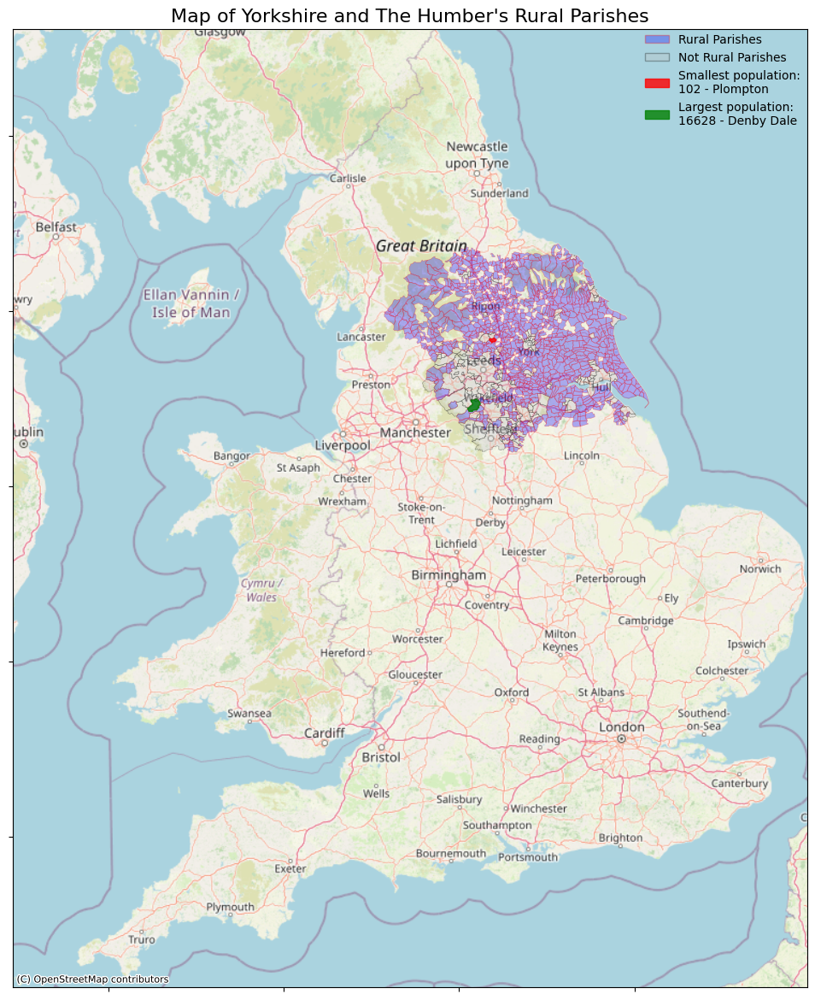

In [23]:
from shapely.ops import cascaded_union

fig, ax = plt.subplots(figsize=(12,18))
mini = mergey[mergey.RGN22NM == 'Yorkshire and The Humber']
# Define Overall Polygon
#overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))
# Define bounding box
#bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)


# Plot borough borders
mini[mini.rural_label != 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='black', 
    linewidth=0.5,
    facecolor='silver',
)

mini[mini.rural_label == 'Rural'].plot(
    ax=ax, 
    alpha=0.3, 
    edgecolor='red', 
    linewidth=0.5,
    facecolor='blue',
)

mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='red',
    linewidth=1,
    facecolor='red'
)

mini[mini.rural_label=='Rural'].sort_values(by='population', ascending=False).head(1).plot(
    ax=ax,
    alpha=0.8,
    edgecolor='green',
    linewidth=1,
    facecolor='green'
)



import contextily as cx # map backgrounds
# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

import matplotlib.patches as mpatches
rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
small_population_patch = mpatches.Patch(
    facecolor='red', 
    edgecolor='red', 
    alpha=0.8, 
    label='Smallest population:\n{0} - {1}'.format(
        mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
        mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
    )
)

large_population_patch = mpatches.Patch(
    facecolor='green', 
    edgecolor='green', 
    alpha=0.8, 
    label='Largest population:\n{0} - {1}'.format(
        mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
        mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
    )
)
leg = plt.legend(
    handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
    bbox_to_anchor=(0.79, 1),
    loc=2,
    borderaxespad=0.,
    frameon=False,
    prop={'size': 10}
)
plt.title("Map of Yorkshire and The Humber's Rural Parishes", fontsize=16)

plt.savefig('../results/map_of_rural_parishes_yorkshire.png')

plt.show()

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


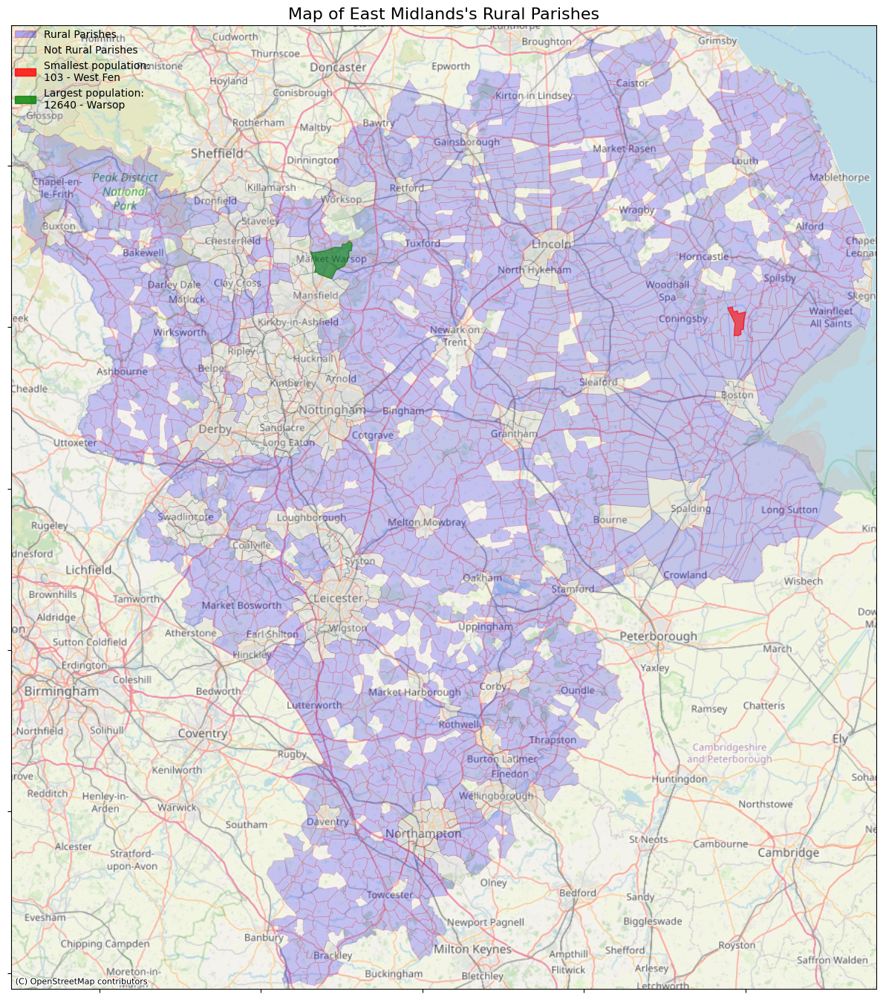

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


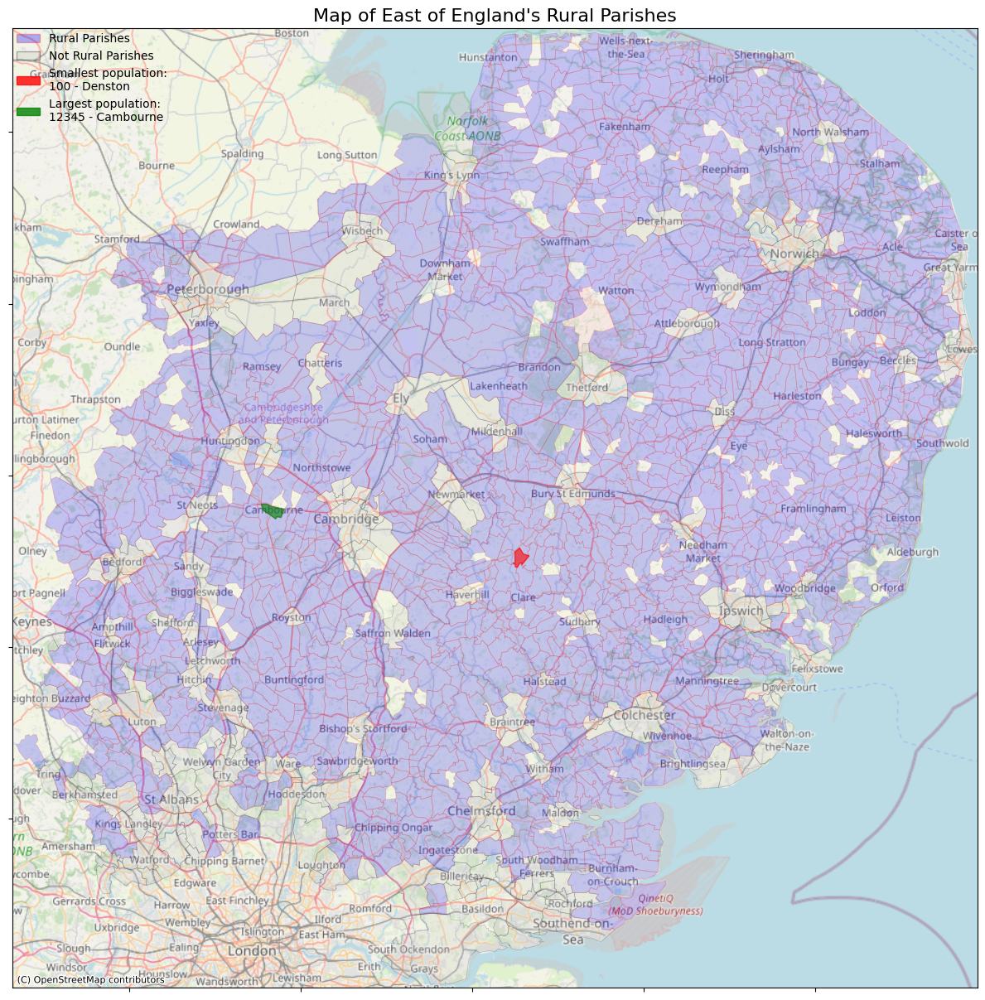

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


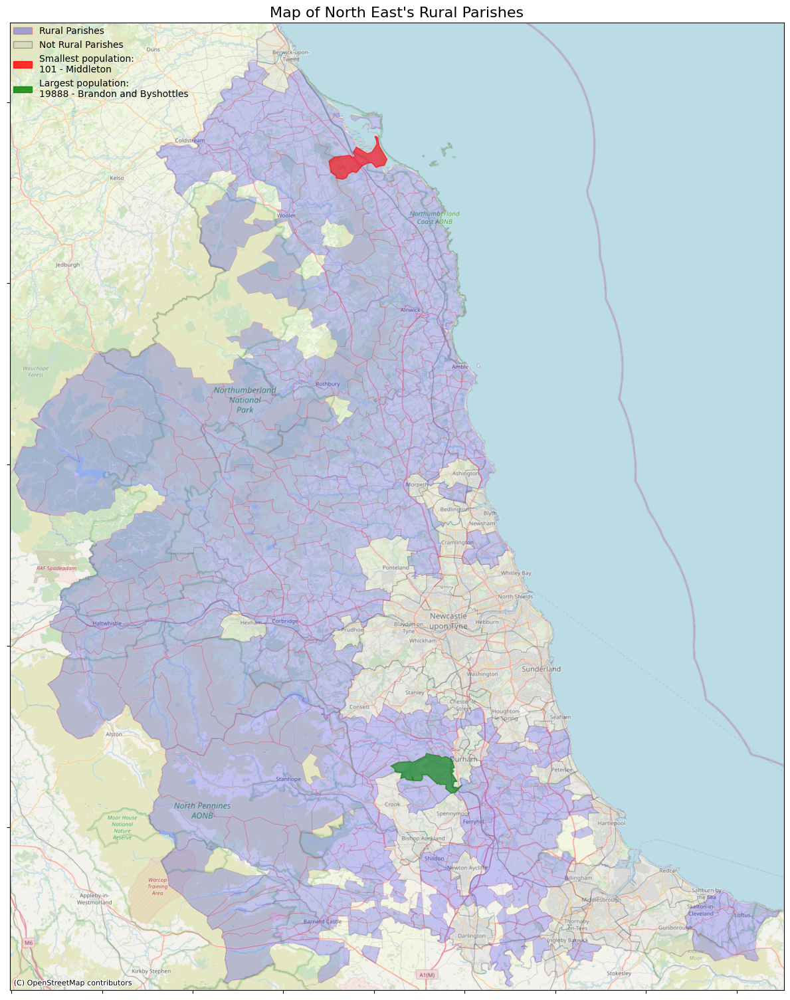

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


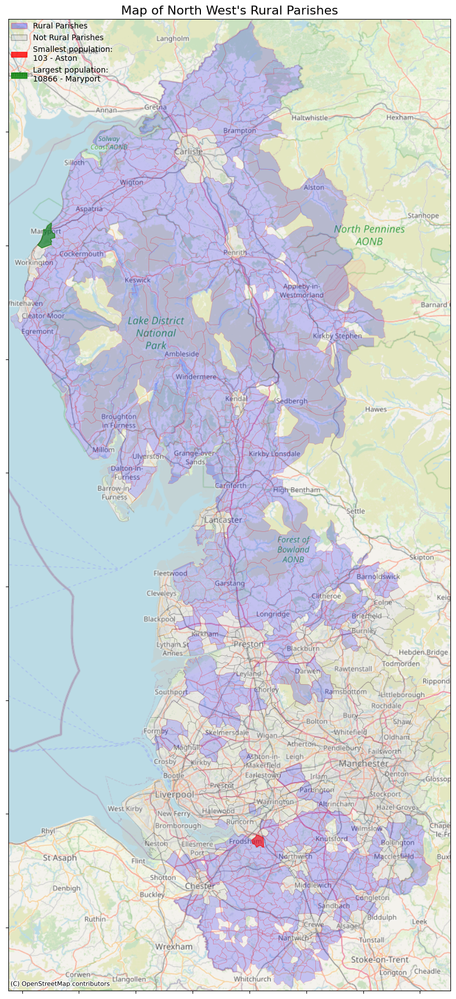

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


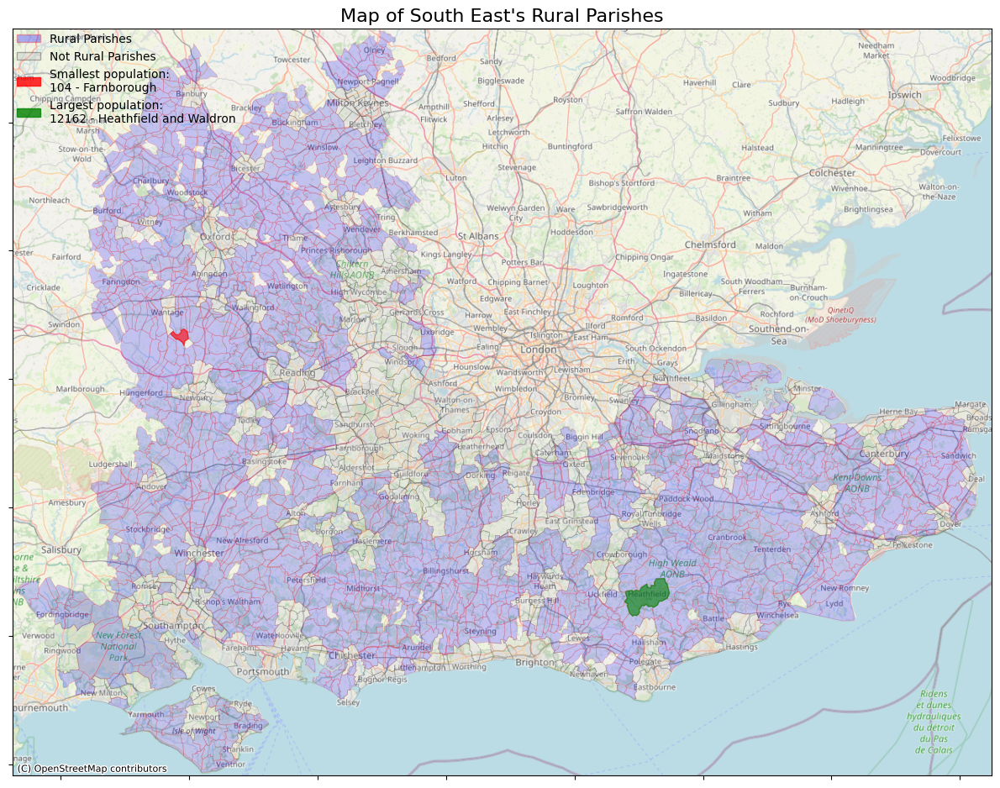

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


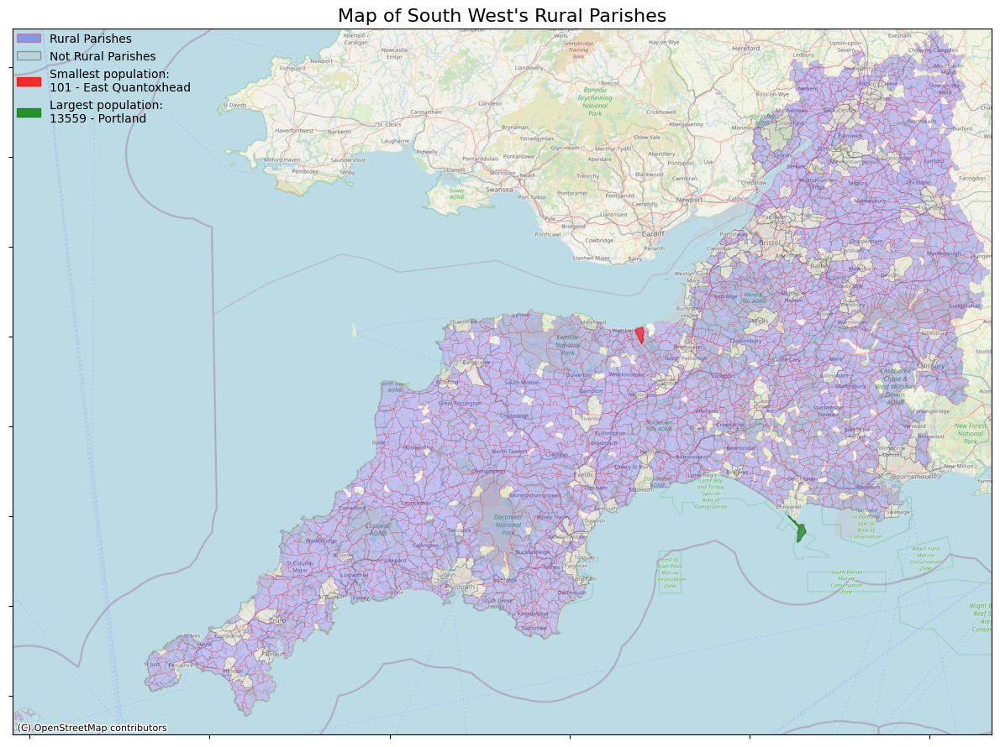

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


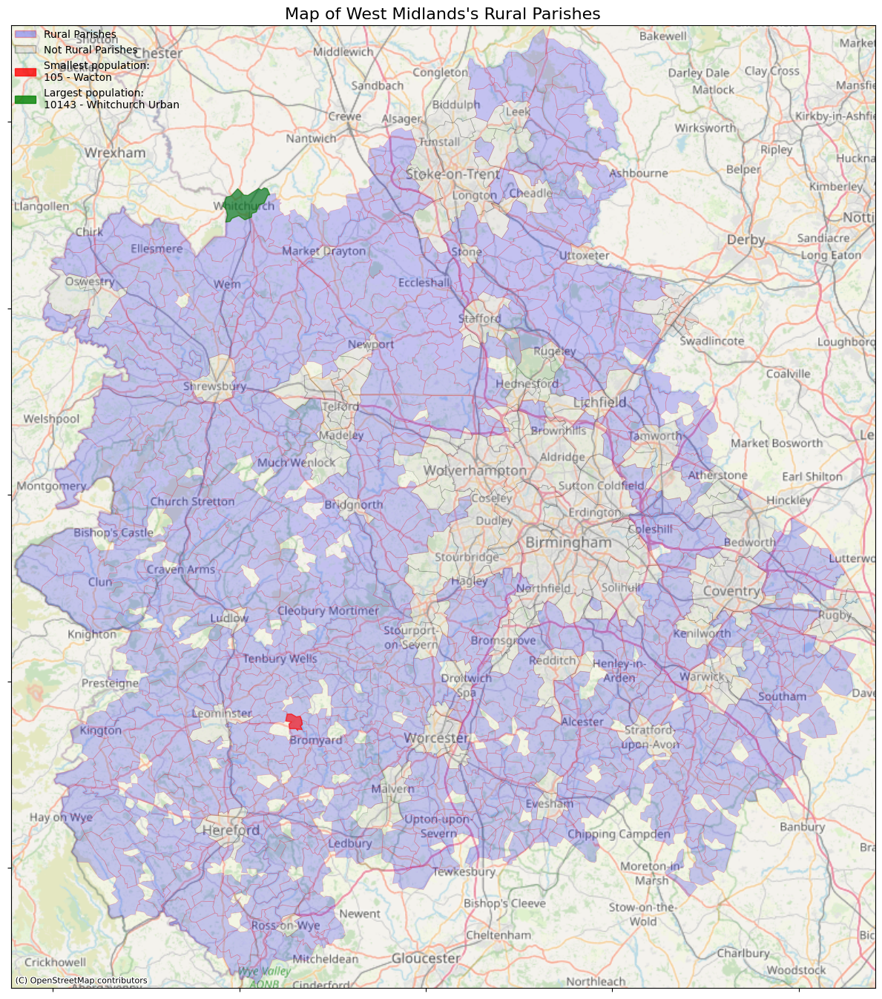

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3798723058.py:8: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))


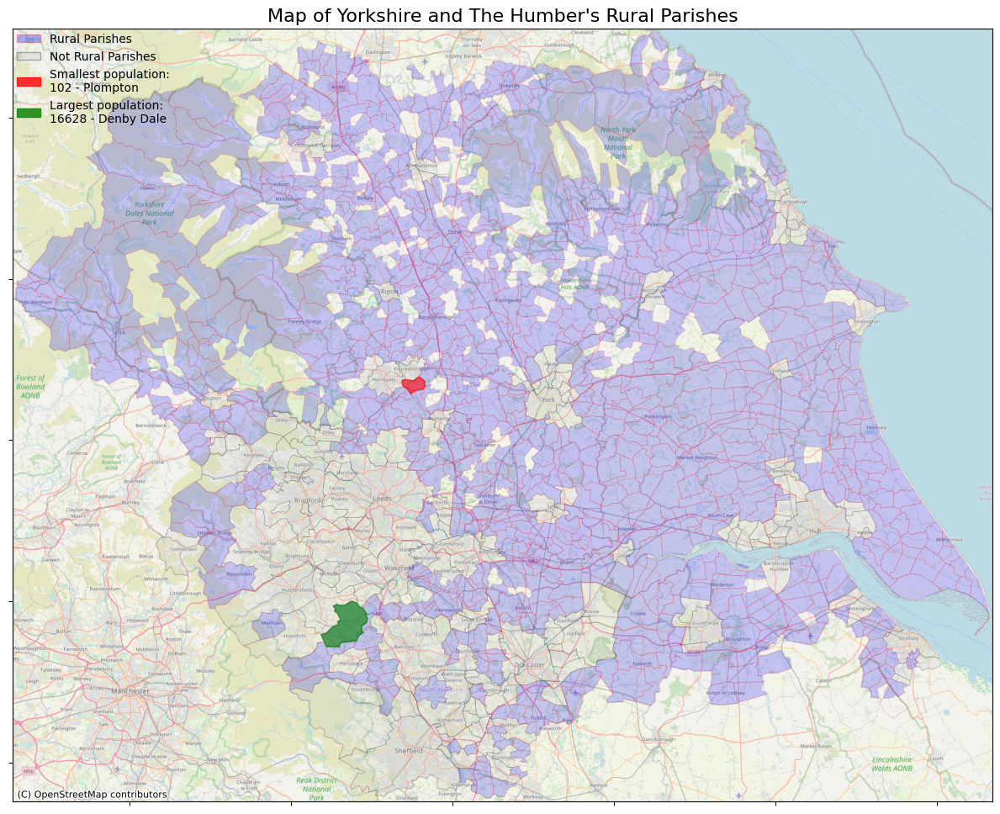

In [24]:
from shapely.ops import cascaded_union

for rgnnm, mini in mergey.groupby(['RGN22NM']):
    if mini[mini.rural_label == 'Rural'].shape[0] < 5:
        continue
    fig, ax = plt.subplots(figsize=(12,18))
    # Define Overall Polygon
    overall_polygon = gdp.GeoSeries(cascaded_union(mini.geometry))
    # Define bounding box
    bounds = overall_polygon.bounds
    bounding_box = [
        bounds['minx'][0],
        bounds['maxx'][0],
        bounds['miny'][0],
        bounds['maxy'][0],
    ]
    # Set bounds
    ax.set_xlim(bounding_box[0]-1000, bounding_box[1] + 1000)
    ax.set_ylim(bounding_box[2]-1000, bounding_box[3] + 1000)

    
    # Plot borough borders
    mini[mini.rural_label != 'Rural'].plot(
        ax=ax, 
        alpha=0.2, 
        edgecolor='black', 
        linewidth=0.5,
        facecolor='silver',
    )

    mini[mini.rural_label == 'Rural'].plot(
        ax=ax, 
        alpha=0.2, 
        edgecolor='red', 
        linewidth=0.5,
        facecolor='blue',
    )

    mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).plot(
        ax=ax,
        alpha=0.6,
        edgecolor='red',
        linewidth=1,
        facecolor='red'
    )

    mini[mini.rural_label=='Rural'].sort_values(by='population', ascending=False).head(1).plot(
        ax=ax,
        alpha=0.6,
        edgecolor='green',
        linewidth=1,
        facecolor='green'
    )

    import contextily as cx # map backgrounds
    # Add background
    cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.8)

    # Remove axis 
    ax.set_yticklabels([])
    ax.set_xticklabels([])

    import matplotlib.patches as mpatches
    rural_patch = mpatches.Patch(facecolor='blue', edgecolor='red', alpha=0.3, label='Rural Parishes')
    not_rural_patch = mpatches.Patch(facecolor='silver', edgecolor='black', alpha=0.3, label='Not Rural Parishes')
    small_population_patch = mpatches.Patch(
        facecolor='red', 
        edgecolor='red', 
        alpha=0.8, 
        label='Smallest population:\n{0} - {1}'.format(
            mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).population.values[0],
            mini[mini.rural_label == 'Rural'].sort_values(by='population').head(1).PARNCP21NM.values[0]
        )
    )

    large_population_patch = mpatches.Patch(
        facecolor='green', 
        edgecolor='green', 
        alpha=0.8, 
        label='Largest population:\n{0} - {1}'.format(
            mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).population.values[0],
            mini[mini.rural_label == 'Rural'].sort_values(by='population', ascending=False).head(1).PARNCP21NM.values[0]
        )
    )
    leg = plt.legend(
        handles=[rural_patch, not_rural_patch, small_population_patch, large_population_patch],
#        bbox_to_anchor=(0.79, 1),
        loc=2,
        borderaxespad=0.,
        frameon=False,
        prop={'size': 10}
    )
    plt.title("Map of {0}\'s Rural Parishes".format(rgnnm[0]), fontsize=16)
    plt.tight_layout()
    plt.savefig('../results/map_of_rural_parishes_{0}.png'.format(rgnnm[0]))

    plt.show()

### Shops by region

In [25]:
mergey.head()

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
0,1,E04000001,Blackrod,NaN,361020,410662,-2.59036,53.591091,14444.180308,8.373290e+06,"POLYGON ((-286096.135 7093910.215, -284094.155...",E04000001,Blackrod,North West,5517,8.599134e+06,Urban
1,2,E04000002,Horwich,NaN,365741,411963,-2.51919,53.603111,20207.437672,1.454181e+07,"POLYGON ((-279457.871 7099705.842, -280193.379...",E04000002,Horwich,North West,20908,1.424275e+07,Mixed
2,3,E04000003,Westhoughton,NaN,365008,406179,-2.52961,53.551079,19733.095935,1.803568e+07,"POLYGON ((-278326.427 7083159.503, -279065.547...",E04000003,Westhoughton,North West,25340,1.786415e+07,Mixed
3,5,E04000005,Saddleworth,NaN,400672,407034,-1.99132,53.559940,41614.516542,7.587037e+07,"POLYGON ((-223693.396 7097907.619, -220596.023...",E04000005,Saddleworth,North West,25466,7.613353e+07,Mixed
4,6,E04000008,Mossley,NaN,398518,402180,-2.02381,53.516312,15077.441495,8.405358e+06,"POLYGON ((-221056.954 7079100.960, -223662.708...",E04000008,Mossley,North West,11566,8.658747e+06,Mixed


In [26]:
import glob
to_include = list(set(glob.glob('../output_data/all_data_final_updated_*.json')) - set(glob.glob('output_data/all_data_final_updated_errors*.json')))
region_frames = [pd.read_json(i) for i in to_include]
big_df = pd.concat(region_frames)
big_df.shape


(178792, 4)

In [27]:
big_df.head()

,OA21CD,RGN22NM,amenities,0
0,E00060311,North East,"[{'name': 'N/A', 'amenity': 'post_box', 'data_...",NaN
1,E00060356,North East,"[{'name': 'The Bull and Dog', 'amenity': 'pub'...",NaN
2,E00060360,North East,[],NaN
3,E00060357,North East,"[{'name': 'N/A', 'amenity': 'waste_basket', 'd...",NaN
4,E00060359,North East,[],NaN


In [28]:
oa_to_parish_lookup = pd.read_csv('../data/OAs_(2021)_to_Civil_Parish_and_Non-Civil_Parished_Areas_to_LTLA_to_UTLA_to_Region_to_Country_(May_2022)_Lookup_in_England_and_Wales.csv')
oa_to_parish_lookup = oa_to_parish_lookup[[
    'OA21CD',
    'PAR22CD',
    'PAR22NM',
    'RGN22NM'
]]
oa_populations = pd.read_csv('../data/census2021-ts001-oa.csv')
oa_total_frame = oa_to_parish_lookup.merge(
    oa_populations[['geography code', 'Residence type: Total; measures: Value']], 
    how='inner', 
    left_on='OA21CD', 
    right_on='geography code')
oa_total_frame = oa_total_frame.rename(columns={'Residence type: Total; measures: Value': 'population'}, errors='raise')
oa_total_frame = oa_total_frame[[
    'OA21CD',
    'PAR22CD',
    'PAR22NM',
    'RGN22NM',
    'population'
]]
size_frame = pd.read_csv('../geo_data/Output_Areas_Dec_2021_Boundaries_Full_Clipped_EW_BFC_2022_-340120420164038365.csv')
oa_total_frame = oa_total_frame.merge(
    size_frame[['OA21CD', 'Shape__Area']],
    how='inner',
    on='OA21CD'
)
oa_total_frame = oa_total_frame.rename(
    columns={'Shape__Area': 'area'}, 
    errors='raise'
)
oa_total_frame = oa_total_frame.merge(
    big_df[['OA21CD', 'amenities']],
    how='left',
    on='OA21CD'
)
oa_total_frame.head()

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/2679317951.py:1: DtypeWarning: Columns (4,7,10,13) have mixed types. Specify dtype option on import or set low_memory=False.
  oa_to_parish_lookup = pd.read_csv('../data/OAs_(2021)_to_Civil_Parish_and_Non-Civil_Parished_Areas_to_LTLA_to_UTLA_to_Region_to_Country_(May_2022)_Lookup_in_England_and_Wales.csv')


,OA21CD,PAR22CD,PAR22NM,RGN22NM,population,area,amenities
0,E00060311,E04000255,Dalton Piercy,North East,312,6.758443e+06,"[{'name': 'N/A', 'amenity': 'post_box', 'data_..."
1,E00060356,E04000257,Greatham,North East,283,5.098650e+05,"[{'name': 'The Bull and Dog', 'amenity': 'pub'..."
2,E00060360,E04000257,Greatham,North East,274,6.863565e+04,[]
3,E00060357,E04000257,Greatham,North East,298,3.589880e+05,"[{'name': 'N/A', 'amenity': 'waste_basket', 'd..."
4,E00060359,E04000257,Greatham,North East,274,6.126857e+04,[]


In [29]:
drop_wales = oa_total_frame[oa_total_frame.RGN22NM != 'Wales']
drop_wales.shape

(178605, 7)

In [30]:
rural_urban_lookup = pd.read_csv('../data/RUC11_OA11_EW.csv')
oa11_oa21_lookup = pd.read_csv('../data/OA_(2011)_to_OA_(2021)_to_Local_Authority_District_(2022)_for_England_and_Wales_Lookup_(Version_2).csv')
rural_urban_lookup = rural_urban_lookup[['OA11CD', 'RUC11CD', 'RUC11']].merge(
    oa11_oa21_lookup[['OA11CD', 'OA21CD']],
    how='left',
    on='OA11CD'
)

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/769130007.py:2: DtypeWarning: Columns (6) have mixed types. Specify dtype option on import or set low_memory=False.
  oa11_oa21_lookup = pd.read_csv('../data/OA_(2011)_to_OA_(2021)_to_Local_Authority_District_(2022)_for_England_and_Wales_Lookup_(Version_2).csv')


In [31]:
with_rural = drop_wales.merge(
    rural_urban_lookup[[
        'OA21CD',
        'RUC11CD',
        'RUC11'
    ]],
    how='left',
    on='OA21CD'
)

In [32]:
official_rural_list = [
    'D1', 'E1', 'F1', 'D2', 'E2', 'F2'
]
with_rural['is_rural'] = with_rural.RUC11CD.isin(official_rural_list)

import collections

def extract_amenity_list(value):
    return collections.Counter([entry['amenity'] for entry in value])

with_rural['amenity_list'] = with_rural.amenities.apply(extract_amenity_list)

In [33]:
parish_amenities = with_rural.groupby(['PAR22CD', 'PAR22NM', 'RGN22NM']).amenity_list.sum(collections.Counter()).reset_index()
parish_data = parish_frame.merge(parish_amenities, how='inner', on=['PAR22CD', 'PAR22NM', 'RGN22NM'])

In [34]:
def classify_parish(x):
    if x == 0:
        return 'Urban'
    elif x == 1:
        return 'Rural'
    else:
        return 'Mixed'
classification['rural_label'] = classification.is_rural.apply(classify_parish)

In [35]:
parish_data = parish_data.merge(classification[['PAR22CD', 'rural_label']], how='inner', on='PAR22CD')

In [36]:
parish_data.head()

,PAR22CD,PAR22NM,RGN22NM,population,area,amenity_list,rural_label
0,E04000001,Blackrod,North West,5517,8.599134e+06,"{'post_box': 3, 'place_of_worship': 2, 'fast_f...",Urban
1,E04000002,Horwich,North West,20908,1.424275e+07,"{'waste_basket': 6, 'parking': 48, 'school': 9...",Mixed
2,E04000003,Westhoughton,North West,25340,1.786415e+07,"{'waste_basket': 22, 'charging_station': 1, 'a...",Mixed
3,E04000005,Saddleworth,North West,25466,7.613353e+07,"{'parking': 115, 'telephone': 8, 'bench': 63, ...",Mixed
4,E04000008,Mossley,North West,11566,8.658747e+06,"{'place_of_worship': 5, 'parking': 16, 'waste_...",Mixed


In [37]:
with_rural.head()

,OA21CD,PAR22CD,PAR22NM,RGN22NM,population,area,amenities,RUC11CD,RUC11,is_rural,amenity_list
0,E00060311,E04000255,Dalton Piercy,North East,312,6.758443e+06,"[{'name': 'N/A', 'amenity': 'post_box', 'data_...",E1,Rural village,True,"{'post_box': 1, 'telephone': 1, 'parking': 2, ..."
1,E00060356,E04000257,Greatham,North East,283,5.098650e+05,"[{'name': 'The Bull and Dog', 'amenity': 'pub'...",C1,Urban city and town,False,"{'pub': 3, 'place_of_worship': 1, 'post_box': 1}"
2,E00060360,E04000257,Greatham,North East,274,6.863565e+04,[],C1,Urban city and town,False,{}
3,E00060357,E04000257,Greatham,North East,298,3.589880e+05,"[{'name': 'N/A', 'amenity': 'waste_basket', 'd...",D1,Rural town and fringe,True,"{'waste_basket': 1, 'parking': 2}"
4,E00060359,E04000257,Greatham,North East,274,6.126857e+04,[],C1,Urban city and town,False,{}


In [38]:
mergey.head()

,OBJECTID,PARNCP21CD,PARNCP21NM,PARNCP21NW,BNG_E,BNG_N,LONG,LAT,SHAPE_Leng,SHAPE_Area,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,rural_label
0,1,E04000001,Blackrod,NaN,361020,410662,-2.59036,53.591091,14444.180308,8.373290e+06,"POLYGON ((-286096.135 7093910.215, -284094.155...",E04000001,Blackrod,North West,5517,8.599134e+06,Urban
1,2,E04000002,Horwich,NaN,365741,411963,-2.51919,53.603111,20207.437672,1.454181e+07,"POLYGON ((-279457.871 7099705.842, -280193.379...",E04000002,Horwich,North West,20908,1.424275e+07,Mixed
2,3,E04000003,Westhoughton,NaN,365008,406179,-2.52961,53.551079,19733.095935,1.803568e+07,"POLYGON ((-278326.427 7083159.503, -279065.547...",E04000003,Westhoughton,North West,25340,1.786415e+07,Mixed
3,5,E04000005,Saddleworth,NaN,400672,407034,-1.99132,53.559940,41614.516542,7.587037e+07,"POLYGON ((-223693.396 7097907.619, -220596.023...",E04000005,Saddleworth,North West,25466,7.613353e+07,Mixed
4,6,E04000008,Mossley,NaN,398518,402180,-2.02381,53.516312,15077.441495,8.405358e+06,"POLYGON ((-221056.954 7079100.960, -223662.708...",E04000008,Mossley,North West,11566,8.658747e+06,Mixed


In [62]:
oa_geo_df.head()

,OA21CD,GlobalID,geometry
0,E00000001,b6c81a78-d070-4324-a2e9-3522777aca9c,"POLYGON ((-10520.211 6713753.241, -10523.786 6..."
1,E00000003,9be984cf-6bdf-470b-bd01-16793c7135f5,"POLYGON ((-10663.370 6713808.590, -10663.000 6..."
2,E00000005,6460aa1d-b8b7-4062-a679-354a99d33f73,"POLYGON ((-10720.151 6713676.267, -10725.590 6..."
3,E00000007,de2b0475-c5b9-4aec-8804-43e3e21d54e2,"POLYGON ((-10690.177 6713522.913, -10684.280 6..."
4,E00000010,55b296f3-e208-41a6-a806-1a020ed907a5,"POLYGON ((-10788.372 6714273.583, -10823.254 6..."


In [63]:
big_merge = oa_geo_df.merge(with_rural, how='inner', left_on='OA21CD', right_on='OA21CD')
big_merge.head()

,OA21CD,GlobalID,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,amenities,RUC11CD,RUC11,is_rural,amenity_list
0,E00000001,b6c81a78-d070-4324-a2e9-3522777aca9c,"POLYGON ((-10520.211 6713753.241, -10523.786 6...",E43000191,"City of London, unparished area",London,176,6707.003326,"[{'name': 'N/A', 'amenity': 'car_sharing', 'da...",A1,Urban major conurbation,False,"{'car_sharing': 1, 'police': 1}"
1,E00000003,9be984cf-6bdf-470b-bd01-16793c7135f5,"POLYGON ((-10663.370 6713808.590, -10663.000 6...",E43000191,"City of London, unparished area",London,256,4186.970726,[],A1,Urban major conurbation,False,{}
2,E00000005,6460aa1d-b8b7-4062-a679-354a99d33f73,"POLYGON ((-10720.151 6713676.267, -10725.590 6...",E43000191,"City of London, unparished area",London,112,8736.115654,"[{'name': 'N/A', 'amenity': 'bench', 'data_typ...",A1,Urban major conurbation,False,"{'bench': 1, 'restaurant': 1}"
3,E00000007,de2b0475-c5b9-4aec-8804-43e3e21d54e2,"POLYGON ((-10690.177 6713522.913, -10684.280 6...",E43000191,"City of London, unparished area",London,144,73494.158020,"[{'name': 'N/A', 'amenity': 'bicycle_parking',...",A1,Urban major conurbation,False,"{'bicycle_parking': 5, 'atm': 1, 'fast_food': ..."
4,E00000010,55b296f3-e208-41a6-a806-1a020ed907a5,"POLYGON ((-10788.372 6714273.583, -10823.254 6...",E43000191,"City of London, unparished area",London,178,2533.057602,"[{'name': 'People's Choice Cafe', 'amenity': '...",A1,Urban major conurbation,False,"{'restaurant': 1, 'pharmacy': 1, 'dentist': 1,..."


### Only Great Yarmouth

In [64]:
big_merge[big_merge.PAR22NM.str.contains('Yarmouth')].groupby('PAR22NM').population.sum().sort_values(ascending=False).head(20)

PAR22NM
Great Yarmouth, unparished area    53092
Yarmouth                             726
Name: population, dtype: int64

In [66]:
only_gy = big_merge[big_merge.PAR22NM == 'Great Yarmouth, unparished area']
only_gy.head()

,OA21CD,GlobalID,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,amenities,RUC11CD,RUC11,is_rural,amenity_list
128004,E00135141,ade666a8-cd01-4d70-9a1c-aa1aef9855c8,"POLYGON ((192776.931 6910965.488, 192776.864 6...",E43000113,"Great Yarmouth, unparished area",East of England,292,20711.927048,"[{'name': 'N/A', 'amenity': 'toilets', 'data_t...",C1,Urban city and town,False,"{'toilets': 1, 'parking': 1}"
128005,E00135142,a902cf16-f6a9-4076-9211-85fcf9f9ffcb,"POLYGON ((192195.117 6912315.102, 192195.582 6...",E43000113,"Great Yarmouth, unparished area",East of England,286,23773.989227,"[{'name': 'Lacon Arms', 'amenity': 'pub', 'dat...",C1,Urban city and town,False,{'pub': 1}
128006,E00135143,41cee577-f806-40b5-87f8-1b681a4696f2,"POLYGON ((192514.418 6912349.605, 192512.691 6...",E43000113,"Great Yarmouth, unparished area",East of England,262,16877.528610,"[{'name': 'Tasty China', 'amenity': 'restauran...",C1,Urban city and town,False,"{'restaurant': 1, 'post_box': 1, 'fast_food': 1}"
128007,E00135144,b31d7a12-fe60-42f6-b78a-2d2ed637ad84,"POLYGON ((192912.499 6911307.839, 192915.537 6...",E43000113,"Great Yarmouth, unparished area",East of England,381,24686.339813,"[{'name': 'N/A', 'amenity': 'post_box', 'data_...",C1,Urban city and town,False,"{'post_box': 1, 'parking': 3, 'pub': 1}"
128008,E00135145,9a479ee8-9da2-4de8-be0e-6dee731533c8,"POLYGON ((192778.552 6911285.436, 192778.551 6...",E43000113,"Great Yarmouth, unparished area",East of England,284,120880.604568,"[{'name': 'N/A', 'amenity': 'atm', 'data_type'...",C1,Urban city and town,False,"{'atm': 2, 'cafe': 6, 'pharmacy': 1, 'toilets'..."


In [67]:
from shapely.ops import cascaded_union
import contextily as cx
import matplotlib.patches as mpatches

/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/1911856146.py:2: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(only_gy.geometry))


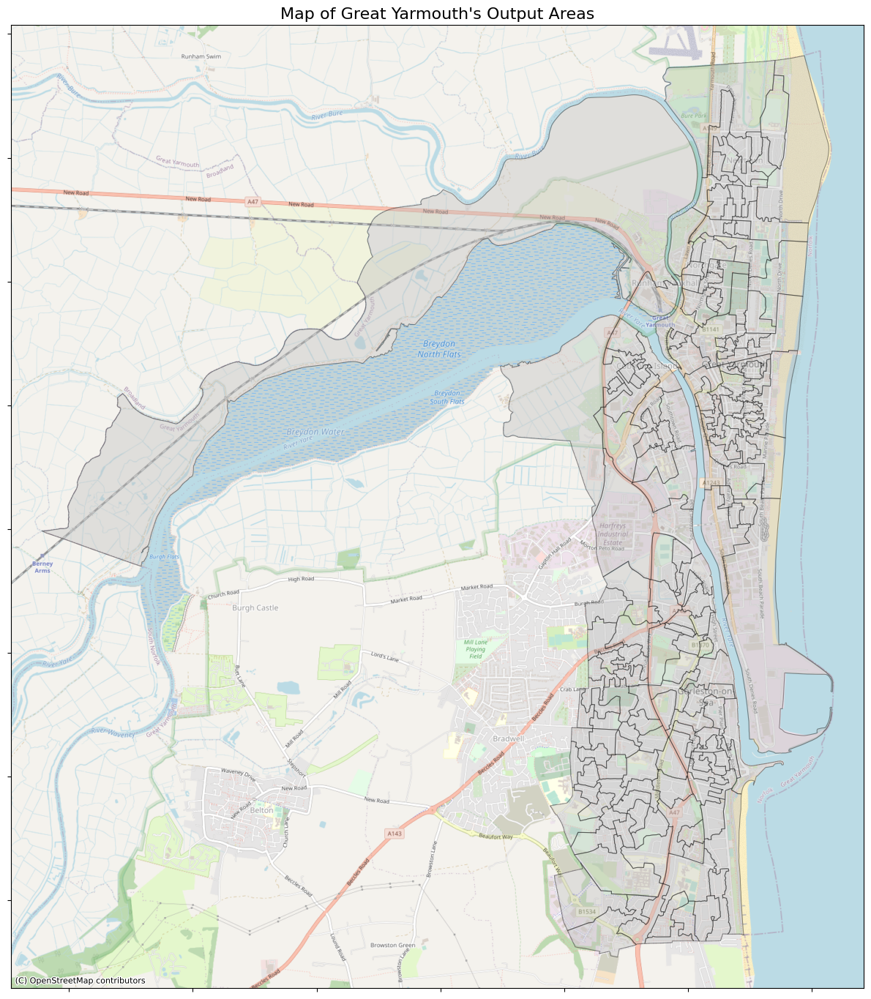

In [75]:
fig, ax = plt.subplots(figsize=(12,18))
overall_polygon = gdp.GeoSeries(cascaded_union(only_gy.geometry))
bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-500, bounding_box[1] + 500)
ax.set_ylim(bounding_box[2]-500, bounding_box[3] + 500)

# Plot borough borders
only_gy.plot(
    ax=ax, 
    alpha=0.4, 
    edgecolor='black', 
    linewidth=0.8,
    facecolor='silver',
)


# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.8)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

plt.title("Map of Great Yarmouth\'s Output Areas", fontsize=16)
plt.tight_layout()
plt.show()

In [80]:
from collections import Counter
gy_list = []
base_counter = Counter()
for item in only_gy.amenity_list.values:
    base_counter.update(item)

In [85]:
not_shop = ['parking', 'post_box', 'bench', 'toilets', 'waste_basket', 'atm', 'shelter', 'bicycle_parking', 'recycling', 'telephone', 'charging_station', 'grave_yard']

In [84]:
base_counter

Counter({'parking': 224,
         'pub': 79,
         'post_box': 75,
         'fast_food': 70,
         'cafe': 69,
         'bench': 66,
         'restaurant': 59,
         'place_of_worship': 28,
         'toilets': 23,
         'waste_basket': 22,
         'school': 21,
         'atm': 20,
         'shelter': 17,
         'pharmacy': 11,
         'bicycle_parking': 11,
         'bank': 11,
         'bar': 10,
         'fuel': 9,
         'car_wash': 7,
         'social_facility': 7,
         'recycling': 7,
         'ice_cream': 7,
         'telephone': 6,
         'community_centre': 6,
         'charging_station': 5,
         'post_office': 5,
         'doctors': 5,
         'nightclub': 4,
         'hospital': 4,
         'veterinary': 4,
         'theatre': 4,
         'police': 3,
         'townhall': 3,
         'marketplace': 2,
         'casino': 2,
         'care_home': 2,
         'taxi': 2,
         'cinema': 2,
         'fire_station': 2,
         'nursing_home': 2,
   

In [86]:
only_gy.head()

,OA21CD,GlobalID,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,amenities,RUC11CD,RUC11,is_rural,amenity_list
128004,E00135141,ade666a8-cd01-4d70-9a1c-aa1aef9855c8,"POLYGON ((192776.931 6910965.488, 192776.864 6...",E43000113,"Great Yarmouth, unparished area",East of England,292,20711.927048,"[{'name': 'N/A', 'amenity': 'toilets', 'data_t...",C1,Urban city and town,False,"{'toilets': 1, 'parking': 1}"
128005,E00135142,a902cf16-f6a9-4076-9211-85fcf9f9ffcb,"POLYGON ((192195.117 6912315.102, 192195.582 6...",E43000113,"Great Yarmouth, unparished area",East of England,286,23773.989227,"[{'name': 'Lacon Arms', 'amenity': 'pub', 'dat...",C1,Urban city and town,False,{'pub': 1}
128006,E00135143,41cee577-f806-40b5-87f8-1b681a4696f2,"POLYGON ((192514.418 6912349.605, 192512.691 6...",E43000113,"Great Yarmouth, unparished area",East of England,262,16877.528610,"[{'name': 'Tasty China', 'amenity': 'restauran...",C1,Urban city and town,False,"{'restaurant': 1, 'post_box': 1, 'fast_food': 1}"
128007,E00135144,b31d7a12-fe60-42f6-b78a-2d2ed637ad84,"POLYGON ((192912.499 6911307.839, 192915.537 6...",E43000113,"Great Yarmouth, unparished area",East of England,381,24686.339813,"[{'name': 'N/A', 'amenity': 'post_box', 'data_...",C1,Urban city and town,False,"{'post_box': 1, 'parking': 3, 'pub': 1}"
128008,E00135145,9a479ee8-9da2-4de8-be0e-6dee731533c8,"POLYGON ((192778.552 6911285.436, 192778.551 6...",E43000113,"Great Yarmouth, unparished area",East of England,284,120880.604568,"[{'name': 'N/A', 'amenity': 'atm', 'data_type'...",C1,Urban city and town,False,"{'atm': 2, 'cafe': 6, 'pharmacy': 1, 'toilets'..."


In [116]:
def get_non_shops(x):
    total_count = 0
    for entry, val in x.items():
        if entry == 'pub':
            total_count += val
    return total_count

In [117]:
only_gy.amenity_list.apply(get_non_shops)

128004    0
128005    1
128006    0
128007    1
128008    4
         ..
160290    0
160293    0
160294    0
173051    1
173077    2
Name: amenity_list, Length: 177, dtype: int64

In [118]:
only_gy = only_gy.assign(num_shops=only_gy.amenity_list.apply(get_non_shops))
only_gy.head()

,OA21CD,GlobalID,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,amenities,RUC11CD,RUC11,is_rural,amenity_list,num_shops,shops_per_person,log_shop
128004,E00135141,ade666a8-cd01-4d70-9a1c-aa1aef9855c8,"POLYGON ((192776.931 6910965.488, 192776.864 6...",E43000113,"Great Yarmouth, unparished area",East of England,292,20711.927048,"[{'name': 'N/A', 'amenity': 'toilets', 'data_t...",C1,Urban city and town,False,"{'toilets': 1, 'parking': 1}",0,0.000000,0.000000
128005,E00135142,a902cf16-f6a9-4076-9211-85fcf9f9ffcb,"POLYGON ((192195.117 6912315.102, 192195.582 6...",E43000113,"Great Yarmouth, unparished area",East of England,286,23773.989227,"[{'name': 'Lacon Arms', 'amenity': 'pub', 'dat...",C1,Urban city and town,False,{'pub': 1},1,0.003497,0.693147
128006,E00135143,41cee577-f806-40b5-87f8-1b681a4696f2,"POLYGON ((192514.418 6912349.605, 192512.691 6...",E43000113,"Great Yarmouth, unparished area",East of England,262,16877.528610,"[{'name': 'Tasty China', 'amenity': 'restauran...",C1,Urban city and town,False,"{'restaurant': 1, 'post_box': 1, 'fast_food': 1}",0,0.007634,1.098612
128007,E00135144,b31d7a12-fe60-42f6-b78a-2d2ed637ad84,"POLYGON ((192912.499 6911307.839, 192915.537 6...",E43000113,"Great Yarmouth, unparished area",East of England,381,24686.339813,"[{'name': 'N/A', 'amenity': 'post_box', 'data_...",C1,Urban city and town,False,"{'post_box': 1, 'parking': 3, 'pub': 1}",1,0.002625,0.693147
128008,E00135145,9a479ee8-9da2-4de8-be0e-6dee731533c8,"POLYGON ((192778.552 6911285.436, 192778.551 6...",E43000113,"Great Yarmouth, unparished area",East of England,284,120880.604568,"[{'name': 'N/A', 'amenity': 'atm', 'data_type'...",C1,Urban city and town,False,"{'atm': 2, 'cafe': 6, 'pharmacy': 1, 'toilets'...",4,0.080986,3.178054


In [119]:
only_gy = only_gy.assign(shops_per_person=only_gy.num_shops / only_gy.population)
only_gy = only_gy.assign(log_shop=np.log(only_gy.num_shops+1))
only_gy.head()

,OA21CD,GlobalID,geometry,PAR22CD,PAR22NM,RGN22NM,population,area,amenities,RUC11CD,RUC11,is_rural,amenity_list,num_shops,shops_per_person,log_shop
128004,E00135141,ade666a8-cd01-4d70-9a1c-aa1aef9855c8,"POLYGON ((192776.931 6910965.488, 192776.864 6...",E43000113,"Great Yarmouth, unparished area",East of England,292,20711.927048,"[{'name': 'N/A', 'amenity': 'toilets', 'data_t...",C1,Urban city and town,False,"{'toilets': 1, 'parking': 1}",0,0.000000,0.000000
128005,E00135142,a902cf16-f6a9-4076-9211-85fcf9f9ffcb,"POLYGON ((192195.117 6912315.102, 192195.582 6...",E43000113,"Great Yarmouth, unparished area",East of England,286,23773.989227,"[{'name': 'Lacon Arms', 'amenity': 'pub', 'dat...",C1,Urban city and town,False,{'pub': 1},1,0.003497,0.693147
128006,E00135143,41cee577-f806-40b5-87f8-1b681a4696f2,"POLYGON ((192514.418 6912349.605, 192512.691 6...",E43000113,"Great Yarmouth, unparished area",East of England,262,16877.528610,"[{'name': 'Tasty China', 'amenity': 'restauran...",C1,Urban city and town,False,"{'restaurant': 1, 'post_box': 1, 'fast_food': 1}",0,0.000000,0.000000
128007,E00135144,b31d7a12-fe60-42f6-b78a-2d2ed637ad84,"POLYGON ((192912.499 6911307.839, 192915.537 6...",E43000113,"Great Yarmouth, unparished area",East of England,381,24686.339813,"[{'name': 'N/A', 'amenity': 'post_box', 'data_...",C1,Urban city and town,False,"{'post_box': 1, 'parking': 3, 'pub': 1}",1,0.002625,0.693147
128008,E00135145,9a479ee8-9da2-4de8-be0e-6dee731533c8,"POLYGON ((192778.552 6911285.436, 192778.551 6...",E43000113,"Great Yarmouth, unparished area",East of England,284,120880.604568,"[{'name': 'N/A', 'amenity': 'atm', 'data_type'...",C1,Urban city and town,False,"{'atm': 2, 'cafe': 6, 'pharmacy': 1, 'toilets'...",4,0.014085,1.609438


/var/folders/zs/1hvc18dn7v94z77k1xy7g90c0000gn/T/ipykernel_67211/3912934324.py:2: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  overall_polygon = gdp.GeoSeries(cascaded_union(only_gy.geometry))


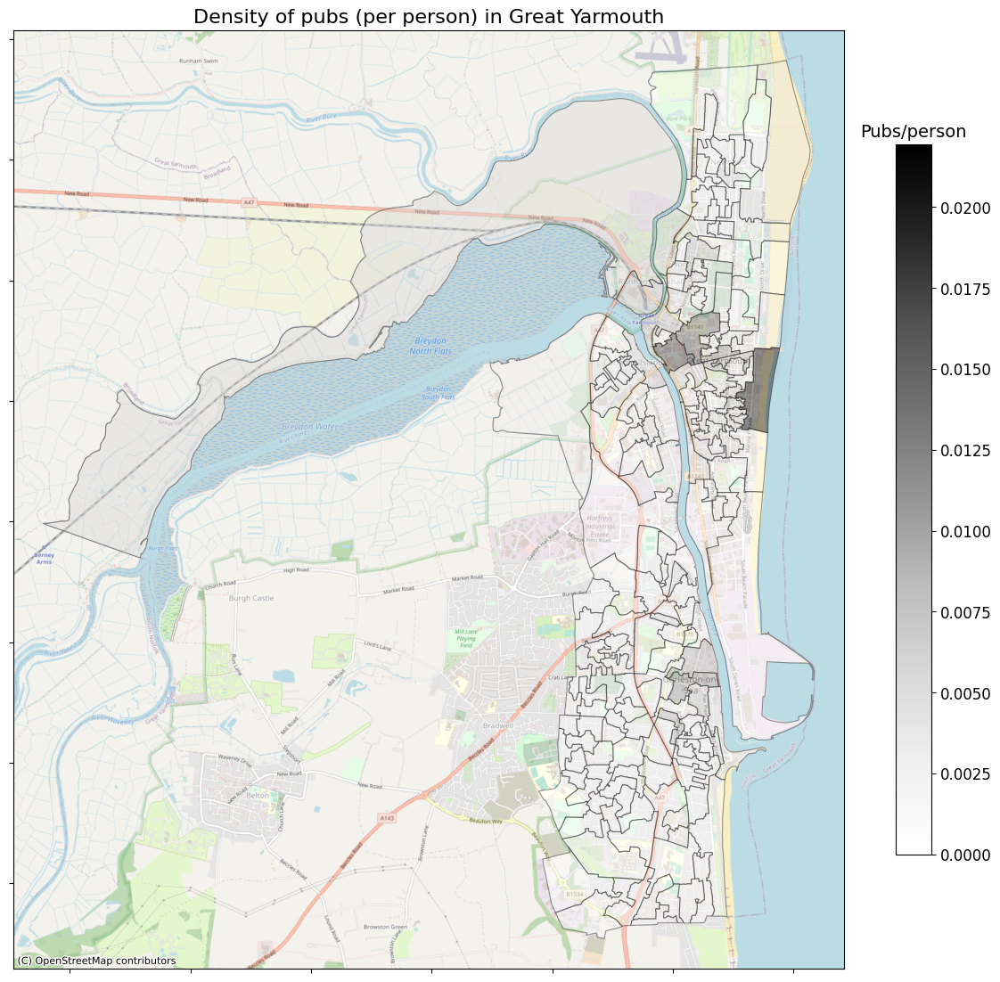

In [125]:
fig, ax = plt.subplots(figsize=(12,18))
overall_polygon = gdp.GeoSeries(cascaded_union(only_gy.geometry))
bounds = overall_polygon.bounds
bounding_box = [
    bounds['minx'][0],
    bounds['maxx'][0],
    bounds['miny'][0],
    bounds['maxy'][0],
]
# Set bounds
ax.set_xlim(bounding_box[0]-500, bounding_box[1] + 500)
ax.set_ylim(bounding_box[2]-500, bounding_box[3] + 500)

# Plot borough borders
only_gy.plot(
    ax=ax, 
    column='shops_per_person',
    alpha=0.4, 
    edgecolor='black', 
    linewidth=0.8,
    cmap='Greys',
    legend=True,
    legend_kwds={'shrink': 0.45}
)

colorbar_ax = ax.get_figure().axes[-1] #to get the last axis of the figure, it's the colorbar axes
colorbar_ax.set_title("Pubs/person", size=14)
colorbar_ax.tick_params(labelsize=12)

# Add background
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.8)

# Remove axis 
ax.set_yticklabels([])
ax.set_xticklabels([])

plt.title("Density of pubs (per person) in Great Yarmouth", fontsize=16)
plt.tight_layout()
plt.savefig('../results/density_of_pubs_great_yarmouth.png', dpi=300, bbox_inches='tight')
plt.show()

In [104]:
ax

<Axes: title={'center': "Map of Great Yarmouth's Output Areas"}>